In [1]:
## Advanced Lane Finding Project

### The goals and steps of this project are the following:

####* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
####* Apply a distortion correction to raw images.
####* Use color transforms, gradients, etc., to create a thresholded binary image.
####* Apply a perspective transform to rectify binary image ("birds-eye view").
####* Detect lane pixels and fit to find the lane boundary.
####* Determine the curvature of the lane and vehicle position with respect to center.
####* Warp the detected lane boundaries back onto the original image.
####* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


In [2]:
## Import Libraries

In [1]:
import numpy as np
import cv2
import pickle
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from ipywidgets import interact, interactive, fixed
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [2]:
## First, compute the camera calibration using chessboard images

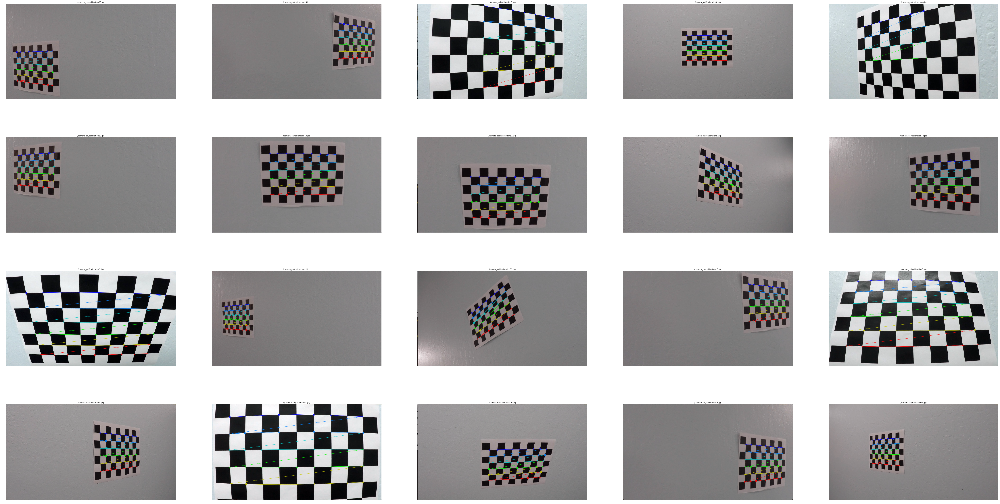

In [3]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

fig, axs = plt.subplots(4,5, figsize=(100,50))
fig.subplots_adjust(hspace = .4, wspace=.05)
axs = axs.ravel()

# Step through the list and search for chessboard corners
for i, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        # this step to refine image points was taken from:
        # http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(corners2)    
        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        axs[i].axis('off')
        axs[i].imshow(img)
        axs[i].set_title(fname, fontsize=10)
    else:
        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,5),None)
        if ret == True:
            #objpoints.append(objp)
            # this step to refine image points was taken from:
            # http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
            #corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
            #imgpoints.append(corners2)    
            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (9,5), corners, ret)
            axs[i].axis('off')
            axs[i].imshow(img)
        else:
            # Find the chessboard corners
            ret, corners = cv2.findChessboardCorners(gray, (8,6),None)
            if ret == True:
                #objpoints.append(objp)
                # this step to refine image points was taken from:
                # http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
                #corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
                #imgpoints.append(corners2)    
                # Draw and display the corners
                img = cv2.drawChessboardCorners(img, (8,6), corners, ret)
                axs[i].axis('off')
                axs[i].imshow(img)
            else:
                # Find the chessboard corners
                ret, corners = cv2.findChessboardCorners(gray, (8,5),None)
                if ret == True:
                    #objpoints.append(objp)
                    # this step to refine image points was taken from:
                    # http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
                    #corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
                    #imgpoints.append(corners2)    
                    # Draw and display the corners
                    img = cv2.drawChessboardCorners(img, (8,5), corners, ret)
                    axs[i].axis('off')
                    axs[i].imshow(img)
                else:
                    # Find the chessboard corners
                    ret, corners = cv2.findChessboardCorners(gray, (8,4),None)
                    if ret == True:
                        #objpoints.append(objp)
                        # this step to refine image points was taken from:
                        # http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
                        #corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
                        #imgpoints.append(corners2)    
                        # Draw and display the corners
                        img = cv2.drawChessboardCorners(img, (8,4), corners, ret)
                        axs[i].axis('off')
                        axs[i].imshow(img)
                    else:
                        # Find the chessboard corners
                        ret, corners = cv2.findChessboardCorners(gray, (7,6),None)
                        if ret == True:
                            #objpoints.append(objp)
                            # this step to refine image points was taken from:
                            # http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
                            #corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
                            #imgpoints.append(corners2)    
                            # Draw and display the corners
                            img = cv2.drawChessboardCorners(img, (7,6), corners, ret)
                            axs[i].axis('off')
                            axs[i].imshow(img)
                        else:
                            # Find the chessboard corners
                            ret, corners = cv2.findChessboardCorners(gray, (7,5),None)
                            if ret == True:
                                #objpoints.append(objp)
                                # this step to refine image points was taken from:
                                # http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
                                #corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
                                #imgpoints.append(corners2)    
                                # Draw and display the corners
                                img = cv2.drawChessboardCorners(img, (7,5), corners, ret)
                                axs[i].axis('off')
                                axs[i].imshow(img)
                            else:
                                # Find the chessboard corners
                                ret, corners = cv2.findChessboardCorners(gray, (7,4),None)
                                if ret == True:
                                    #objpoints.append(objp)
                                    # this step to refine image points was taken from:
                                    # http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
                                    #corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
                                    #imgpoints.append(corners2)    
                                    # Draw and display the corners
                                    img = cv2.drawChessboardCorners(img, (7,4), corners, ret)
                                    axs[i].axis('off')
                                    axs[i].imshow(img)   
        axs[i].set_title("*"+fname, fontsize=10)     
plt.show()

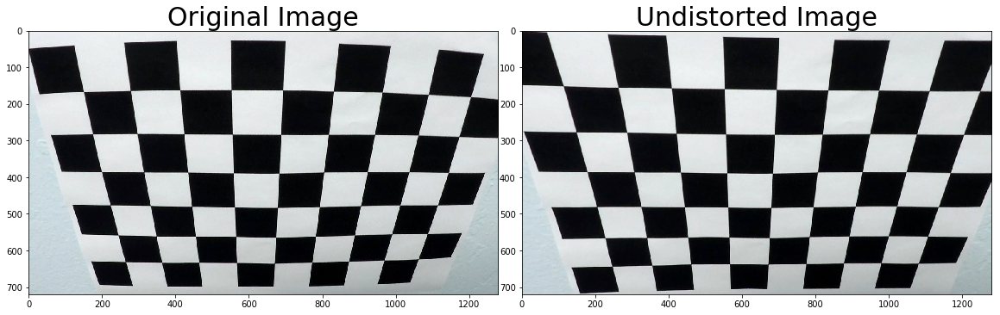

In [4]:
# Test undistortion on an image
img = cv2.imread('./camera_cal/calibration2.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
dst = cv2.undistort(img, mtx, dist, None, mtx)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "calibration.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)
plt.show()

In [5]:
## Camera Calibration on Testing Images

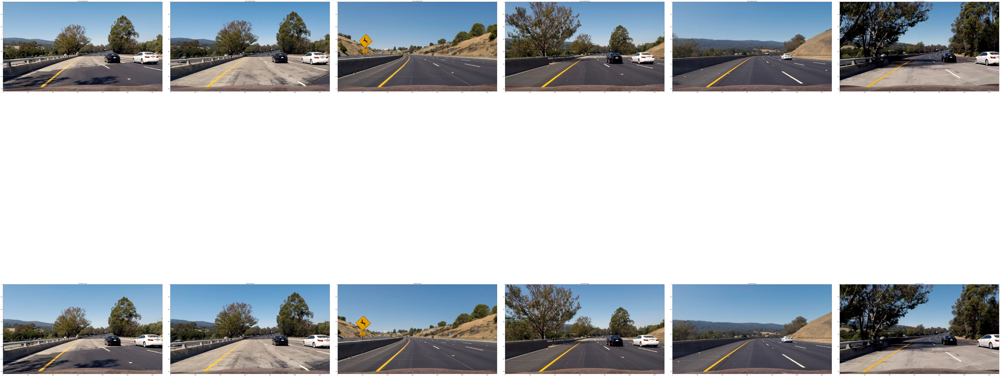

In [6]:
# undistort image using camera calibration matrix from above
def undistort(img):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

# Make a list of testing images
images = glob.glob('./test_images/test*.jpg')

fig, axs = plt.subplots(2,6, figsize=(200,100))
fig.subplots_adjust(hspace = .4, wspace=.05)
axs = axs.ravel()

# Step through the list and undistort the images
img_undist = []
image_orig = []
for i, fname in enumerate(images):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axs[i].imshow(img)
    axs[i].set_title(fname, fontsize=10)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    axs[i+6].imshow(dst)
    axs[i+6].set_title('Undistorted Image', fontsize=10)
    img_undist.append(dst)
    image_orig.append(img)
plt.show()

In [7]:
## Perspective Transform

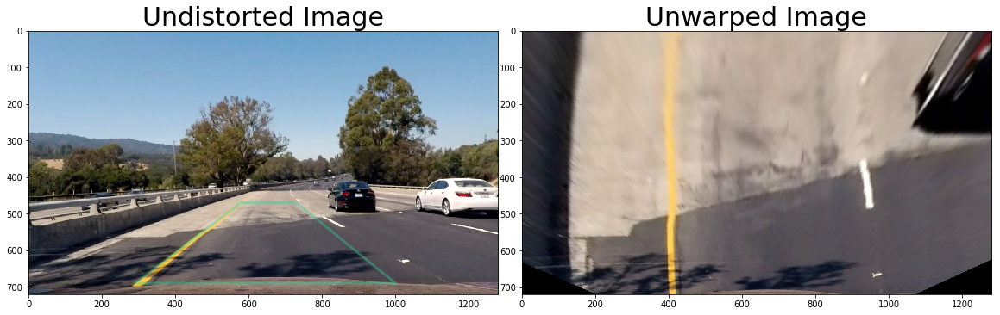

In [8]:
# unwarp the undistorted image
def unwarp(img, src, dst):
    h,w = img.shape[:2]
    # use cv2.getPerspectiveTransform() to get M, the transform matrix, and Minv, the inverse
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # use cv2.warpPerspective() to warp your image to a top-down view
    warped = cv2.warpPerspective(img, M, (w,h), flags=cv2.INTER_LINEAR)
    return warped, M, Minv

h,w = img_undist[0].shape[:2]
# define source and destination points for transform
src = np.float32([(580,470),
                  (730,470), 
                  (290,690), 
                  (1000,690)])
#dst = np.float32([(450,0),
#                  (w-450,0),
#                  (450,h),
#                  (w-450,h)])
offset = 400
dst = np.float32([(offset, 0),
                  (w-offset, 0), 
                  (offset, h), 
                  (w-offset, h)])
img_unwarp, M, Minv = unwarp(img_undist[0], src, dst)
# Visualize unwarp
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img_undist[0])
x = [src[0][0],src[2][0],src[3][0],src[1][0],src[0][0]]
y = [src[0][1],src[2][1],src[3][1],src[1][1],src[0][1]]
ax1.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
ax1.set_ylim([h,0])
ax1.set_xlim([0,w])
ax1.set_title('Undistorted Image', fontsize=30)
ax2.imshow(img_unwarp)
ax2.set_title('Unwarped Image', fontsize=30)
plt.show()


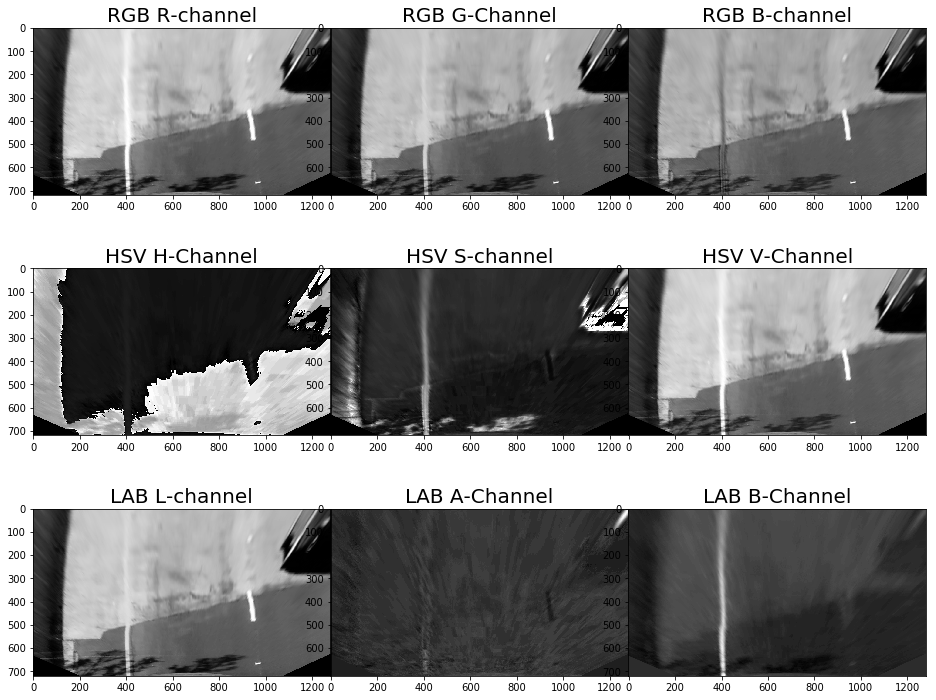

In [9]:
# Visualize multiple color space channels
img_unwarp_R = img_unwarp[:,:,0]
img_unwarp_G = img_unwarp[:,:,1]
img_unwarp_B = img_unwarp[:,:,2]
img_unwarp_HSV = cv2.cvtColor(img_unwarp, cv2.COLOR_RGB2HSV)
img_unwarp_H = img_unwarp_HSV[:,:,0]
img_unwarp_S = img_unwarp_HSV[:,:,1]
img_unwarp_V = img_unwarp_HSV[:,:,2]
img_unwarp_LAB = cv2.cvtColor(img_unwarp, cv2.COLOR_RGB2Lab)
img_unwarp_L = img_unwarp_LAB[:,:,0]
img_unwarp_A = img_unwarp_LAB[:,:,1]
img_unwarp_B2 = img_unwarp_LAB[:,:,2]
fig, axs = plt.subplots(3,3, figsize=(16, 12))
fig.subplots_adjust(hspace = .4, wspace=.001)
axs = axs.ravel()
axs[0].imshow(img_unwarp_R, cmap='gray')
axs[0].set_title('RGB R-channel', fontsize=20)
axs[1].imshow(img_unwarp_G, cmap='gray')
axs[1].set_title('RGB G-Channel', fontsize=20)
axs[2].imshow(img_unwarp_B, cmap='gray')
axs[2].set_title('RGB B-channel', fontsize=20)
axs[3].imshow(img_unwarp_H, cmap='gray')
axs[3].set_title('HSV H-Channel', fontsize=20)
axs[4].imshow(img_unwarp_S, cmap='gray')
axs[4].set_title('HSV S-channel', fontsize=20)
axs[5].imshow(img_unwarp_V, cmap='gray')
axs[5].set_title('HSV V-Channel', fontsize=20)
axs[6].imshow(img_unwarp_L, cmap='gray')
axs[6].set_title('LAB L-channel', fontsize=20)
axs[7].imshow(img_unwarp_A, cmap='gray')
axs[7].set_title('LAB A-Channel', fontsize=20)
axs[8].imshow(img_unwarp_B2, cmap='gray')
axs[8].set_title('LAB B-Channel', fontsize=20)
plt.show()

In [10]:
## Sobel Absolute Threshold

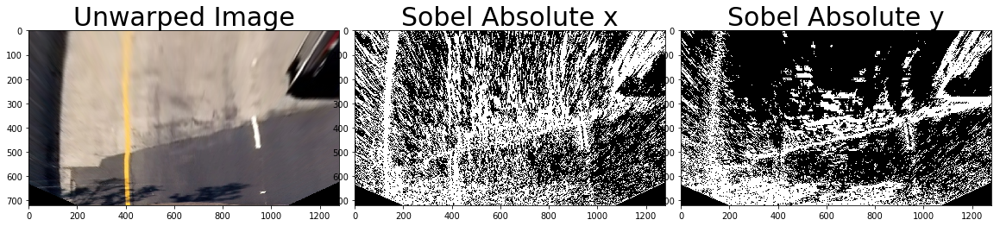

In [11]:
# Define a function that applies Sobel x or y, 
# then takes an absolute value and applies a threshold.
# Note: calling your function with orient='x', thresh_min=5, thresh_max=100
# should produce output like the example image shown above this quiz.
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    # 3) Take the absolute value of the derivative or gradient
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output

# Visualize sobel absolute threshold
min_thresh= 2
max_thresh= 255
img_sobelAbs_x = abs_sobel_thresh(img_unwarp, 'x', min_thresh, max_thresh)
img_sobelAbs_y = abs_sobel_thresh(img_unwarp, 'y', min_thresh, max_thresh)
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img_unwarp)
ax1.set_title('Unwarped Image', fontsize=30)
ax2.imshow(img_sobelAbs_x, cmap='gray')
ax2.set_title('Sobel Absolute x', fontsize=30)
ax3.imshow(img_sobelAbs_y, cmap='gray')
ax3.set_title('Sobel Absolute y', fontsize=30)
plt.show()

In [12]:
## Sobel Magnitude Threshold

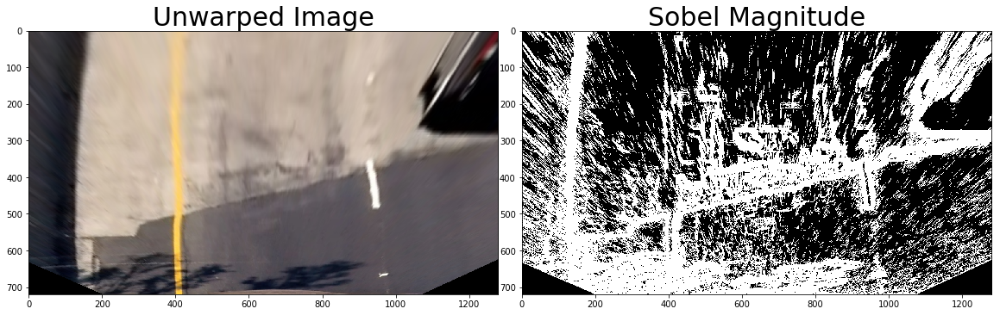

In [13]:
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def mag_sobel_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # 5) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output

# Visualize sobel magnitude threshold
kernel_size = 3
min_thresh= 2
max_thresh= 255
img_sobelMag = mag_sobel_thresh(img_unwarp, kernel_size, (min_thresh, max_thresh))
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img_unwarp)
ax1.set_title('Unwarped Image', fontsize=30)
ax2.imshow(img_sobelMag, cmap='gray')
ax2.set_title('Sobel Magnitude', fontsize=30)
plt.show()

In [14]:
## Sobel Direction Threshold

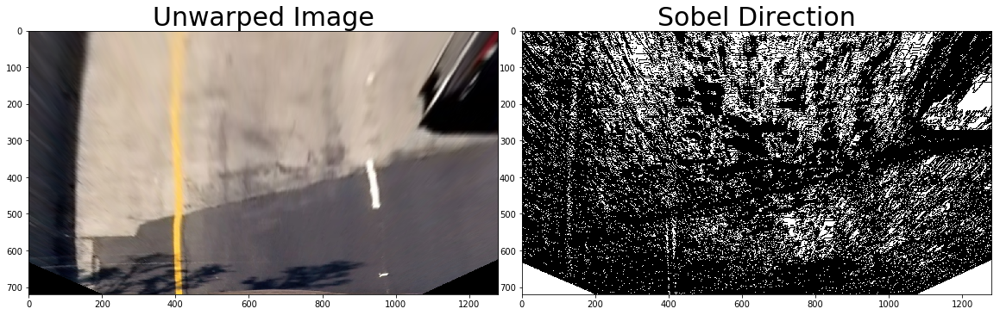

In [15]:
# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_sobel_thresh(img, sobel_kernel=3, thresh=(0, np.pi/2)):    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx)) 
    # 5) Create a binary mask where direction thresholds are met
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output

# Visualize sobel direction threshold
sobel_kernel=15
thresh = (0, 0.1)
img_sobelDir = dir_sobel_thresh(img_unwarp, kernel_size, thresh)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img_unwarp)
ax1.set_title('Unwarped Image', fontsize=30)
ax2.imshow(img_sobelDir, cmap='gray')
ax2.set_title('Sobel Direction', fontsize=30)
plt.show()

In [16]:
## Combine Sobel Magnitude + Direction Threshold

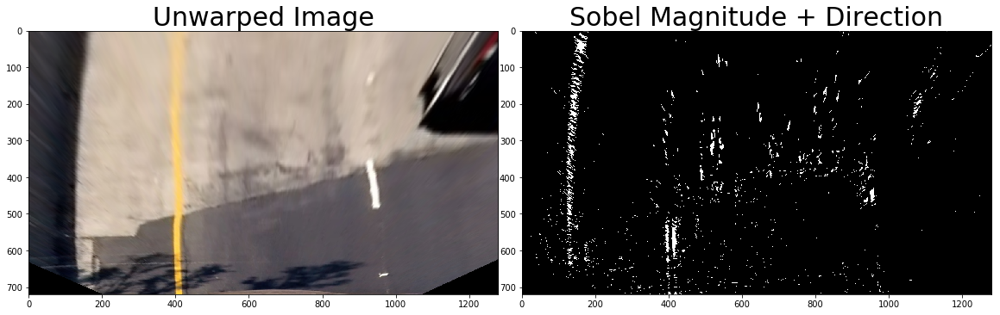

In [17]:
# combine two threashold methods 
mag_kernel_size = 3
mag_min_thresh = 4
mag_max_thresh = 255
dir_kernel_size = 15
dir_thresh = (0, 0.1)
img_sobelMag2 = mag_sobel_thresh(img_unwarp, mag_kernel_size, (mag_min_thresh, mag_max_thresh))
img_sobelDir2 = dir_sobel_thresh(img_unwarp, dir_kernel_size, dir_thresh)
combined = np.zeros_like(img_sobelMag2)
combined[((img_sobelMag2 == 1) & (img_sobelDir2 == 1))] = 1

# Visualize sobel magnitude + direction threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img_unwarp)
ax1.set_title('Unwarped Image', fontsize=30)
ax2.imshow(combined, cmap='gray')
ax2.set_title('Sobel Magnitude + Direction', fontsize=30)
plt.show()

In [18]:
## HLS S-Channel Threshold

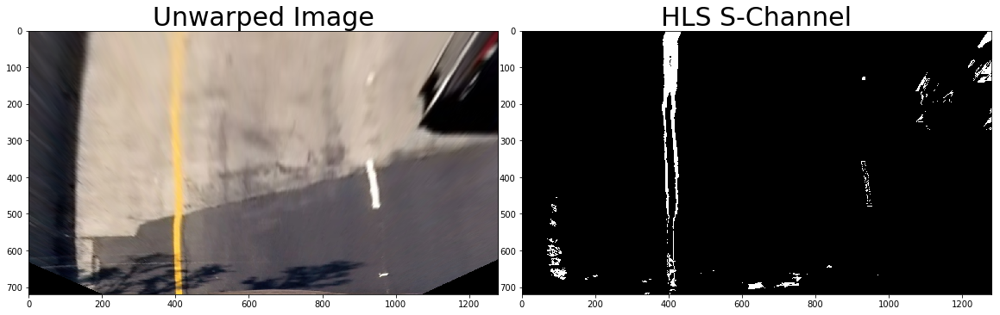

In [19]:
# Define a function that thresholds the S-channel of HLS
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_sthresh(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # 2) Apply a threshold to the S channel
    s_channel = hls[:,:,2]
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    # binary_output = np.copy(img) # placeholder line
    return binary_output

# Visualize hls s-channel threshold
s_thresh = (130, 200)
img_SThresh = hls_sthresh(img_unwarp, s_thresh)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img_unwarp)
ax1.set_title('Unwarped Image', fontsize=30)
ax2.imshow(img_SThresh, cmap='gray')
ax2.set_title('HLS S-Channel', fontsize=30)
plt.show()

In [20]:
## HLS L-Channel Threshold

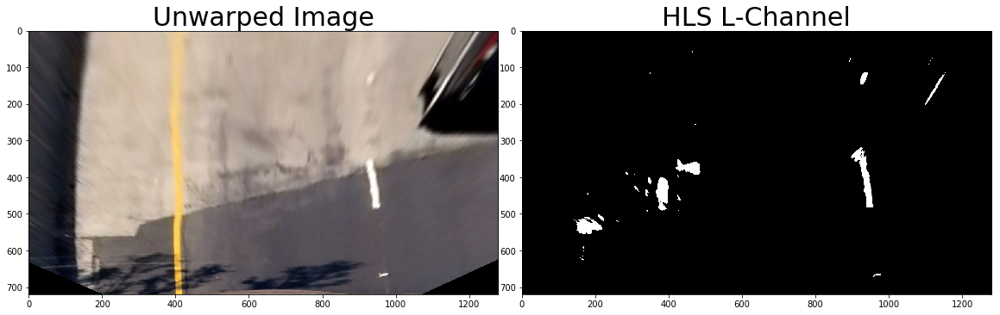

In [21]:
# Define a function that thresholds the L-channel of HLS
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_lthresh(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # 2) Apply a threshold to the S channel
    l_channel = hls[:,:,1]
    binary_output = np.zeros_like(l_channel)
    binary_output[(l_channel > thresh[0]) & (l_channel <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    # binary_output = np.copy(img) # placeholder line
    return binary_output

# Visualize hls l-channel threshold
l_thresh = (200, 255)
img_LThresh = hls_lthresh(img_unwarp, l_thresh)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img_unwarp)
ax1.set_title('Unwarped Image', fontsize=30)
ax2.imshow(img_LThresh, cmap='gray')
ax2.set_title('HLS L-Channel', fontsize=30)
plt.show()

In [22]:
## LAB Colorspace

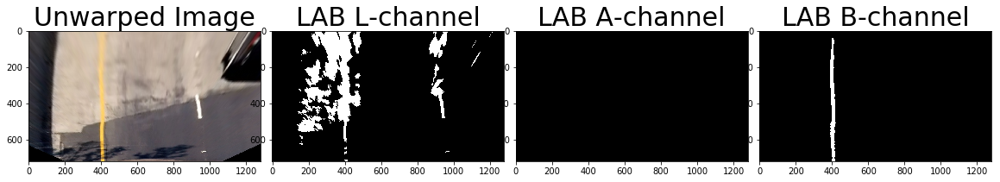

In [23]:
# Define a function that thresholds the B-channel of LAB
# Use exclusive lower bound (>) and inclusive upper (<=), OR the results of the thresholds (B channel should capture
# yellows)
def lab_lthresh(img, thresh=(190,255)):
    # 1) Convert to LAB color space
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    #lab_b = lab[:,:,0]
    lab_l,lab_a,lab_b = cv2.split(lab)
    # don't normalize if there are no yellows in the image
    if np.max(lab_l) > 175:
        lab_l = lab_l*(255/np.max(lab_l))
    # 2) Apply a threshold to the L channel
    binary_output = np.zeros_like(lab_l)
    binary_output[((lab_l > thresh[0]) & (lab_l <= thresh[1]))] = 1
    # 3) Return a binary image of threshold result
    return binary_output
def lab_athresh(img, thresh=(190,255)):
    # 1) Convert to LAB color space
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    #lab_b = lab[:,:,1]
    lab_l,lab_a,lab_b = cv2.split(lab)
    # don't normalize if there are no yellows in the image
    if np.max(lab_a) > 175:
        lab_a = lab_a*(255/np.max(lab_a))
    # 2) Apply a threshold to the L channel
    binary_output = np.zeros_like(lab_a)
    binary_output[((lab_a > thresh[0]) & (lab_a <= thresh[1]))] = 1
    # 3) Return a binary image of threshold result
    return binary_output
def lab_bthresh(img, thresh=(190,255)):
    # 1) Convert to LAB color space
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    #lab_b = lab[:,:,2]
    lab_l,lab_a,lab_b = cv2.split(lab)
    # don't normalize if there are no yellows in the image
    if np.max(lab_b) > 175:
        lab_b = lab_b*(255/np.max(lab_b))
    # 2) Apply a threshold to the L channel
    binary_output = np.zeros_like(lab_b)
    binary_output[((lab_b > thresh[0]) & (lab_b <= thresh[1]))] = 1
    # 3) Return a binary image of threshold result
    return binary_output

# Visualize LAB L threshold
#lab_lthresh = (210, 255)
img_LLThresh = lab_lthresh(img_unwarp, (200, 255))
#lab_athresh = (210, 255)
img_LAThresh = lab_athresh(img_unwarp, (200, 255))
#lab_bthresh = (210, 255)
img_LBThresh = lab_bthresh(img_unwarp, (200, 255))
f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img_unwarp)
ax1.set_title('Unwarped Image', fontsize=30)
ax2.imshow(img_LLThresh, cmap='gray')
ax2.set_title('LAB L-channel', fontsize=30)
ax3.imshow(img_LAThresh, cmap='gray')
ax3.set_title('LAB A-channel', fontsize=30)
ax4.imshow(img_LBThresh, cmap='gray')
ax4.set_title('LAB B-channel', fontsize=30)
plt.show()

In [24]:
## Image Processing Pipeline

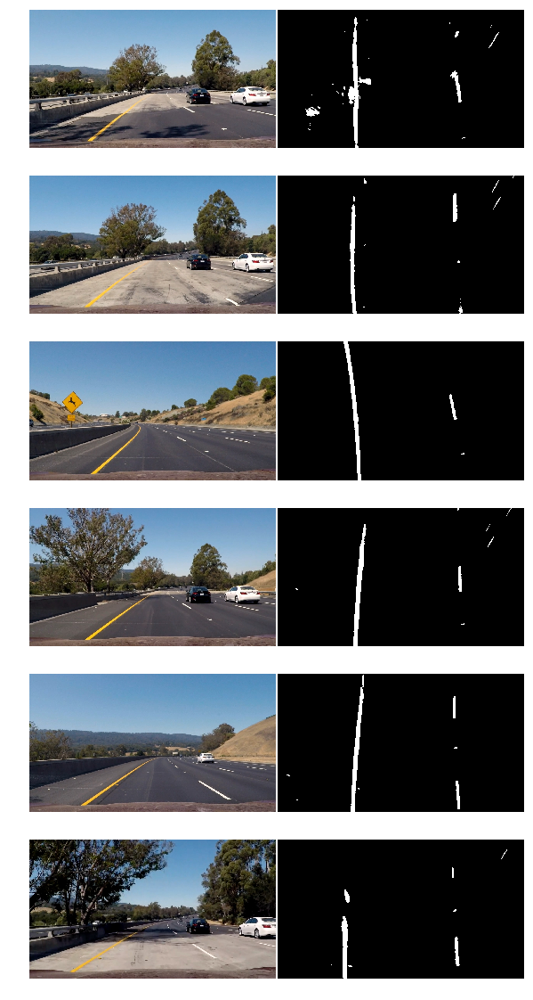

In [25]:
# Entire pipeline from distort image to color space transformation
def pipeline(img):
    # Undistort
    img_undistort = undistort(img)
    
    # Perspective Transform
    src = np.float32([(580,470),
                      (730,470), 
                      (290,690), 
                      (1000,690)])
    offset = 400
    dst = np.float32([(offset, 0),
                      (w-offset, 0), 
                      (offset, h), 
                      (w-offset, h)])
    img_unwarp, M, Minv = unwarp(img_undistort, src, dst)

    # Sobel Absolute (using default parameters)
    #img_sobelAbs = abs_sobel_thresh(img_unwarp)

    # Sobel Magnitude (using default parameters)
    #img_sobelMag = mag_thresh(img_unwarp)
    
    # Sobel Direction (using default parameters)
    #img_sobelDir = dir_thresh(img_unwarp)
    
    # HLS S-channel Threshold (using default parameters)
    #img_SThresh = hls_sthresh(img_unwarp)

    # HLS L-channel Threshold (using default parameters)
    img_LThresh = hls_lthresh(img_unwarp,(200, 255))

    # Lab B-channel Threshold (using default parameters)
    img_BThresh = lab_bthresh(img_unwarp,(200, 255))
    
    # Combine HLS and Lab B channel thresholds
    combined = np.zeros_like(img_BThresh)
    combined[(img_LThresh == 1) | (img_BThresh == 1)] = 1
    return combined, Minv

# Make a list of example images
images = glob.glob('./test_images/test*.jpg')
                                          
# Set up plot
fig, axs = plt.subplots(len(images),2, figsize=(10, 20))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()
     
i = 0
img_proced = []
Minvs = []
for image in images:
    img = cv2.imread(image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_bin, Minv = pipeline(img)
    axs[i].imshow(img)
    axs[i].axis('off')
    i += 1
    axs[i].imshow(img_bin, cmap='gray')
    axs[i].axis('off')
    i += 1
    img_proced.append(img_bin)
    Minvs.append(Minv)
plt.show()

In [26]:
## Histogram of Image Binary

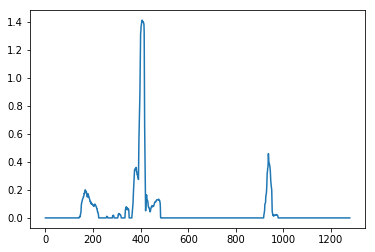

In [27]:
# Load image
# `mpimg.imread` will load .jpg as 0-255, so normalize back to 0-1
#img = mpimg.imread(images[0])/255
img = img_proced[0]/255

def hist(img):
    # TO-DO: Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]

    # TO-DO: Sum across image pixels vertically - make sure to set `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum(bottom_half, axis=0)
    
    return histogram

# Create histogram of image binary activations
histogram = hist(img)

# Visualize the resulting histogram
plt.plot(histogram)
plt.show()

In [28]:
## Sliding Windows

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


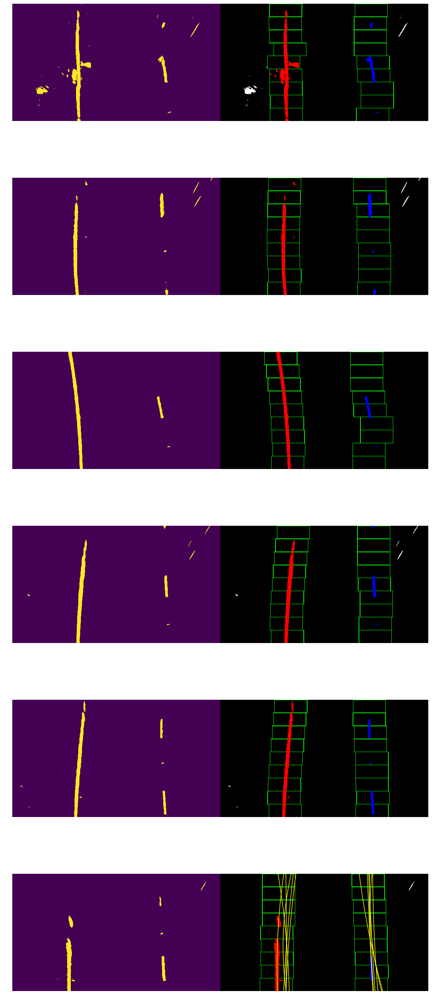

left:
[ 1.31359360e-04 -1.47088319e-01  3.89555931e+02]
right:
[1.94455070e-05 3.25447839e-02 9.04542635e+02]


In [29]:
# Load image
#binary_warped = mpimg.imread('warped_example.jpg')
binary_warped = img_proced[0]

def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        #pass # Remove this when you add your function
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return left_fit, right_fit, out_img
                          
# Set up plot
fig, axs = plt.subplots(len(img_proced),2, figsize=(20, 50))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()
i = 0
left_fits = []
right_fits = []
for i in range(len(img_proced)):
    binary_warped = img_proced[i]
    left_fit, right_fit, out_img = fit_polynomial(binary_warped)
    left_fits.append(left_fit)
    right_fits.append(right_fit)
    axs[2*i].imshow(binary_warped)
    axs[2*i].axis('off')
    axs[2*i+1].imshow(out_img)
    axs[2*i+1].axis('off')
plt.show()
print('left:')
print(left_fit)
print('right:')
print(right_fit)

In [30]:
## Polyfit from Previous Frame

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


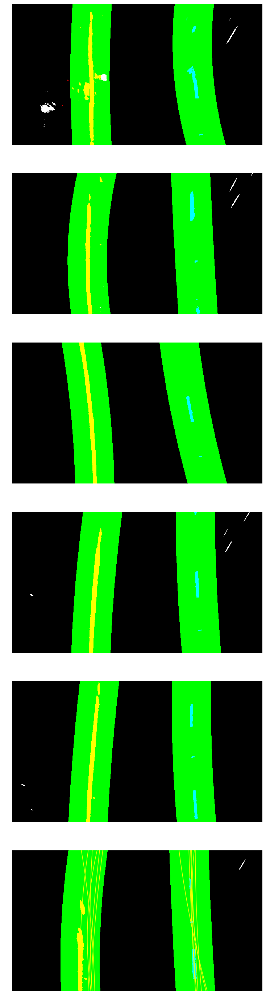

In [31]:
# Load our image - this should be a new frame since last time!
# binary_warped = mpimg.imread('warped_example.jpg')
binary_warped = img_proced[1]

# Polynomial fit values from the previous frame
# Make sure to grab the actual values from the previous step in your project!
#left_fit = np.array([ 2.13935315e-04, -3.77507980e-01,  4.76902175e+02])
#right_fit = np.array([4.17622148e-04, -4.93848953e-01,  1.11806170e+03])

def fit_poly(img_shape, leftx, lefty, rightx, righty):
    ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return left_lane_inds, right_lane_inds, left_fitx, right_fitx, ploty, result

# Set up plot
fig, axs = plt.subplots(len(img_proced),1, figsize=(50, 50))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

i = 0
left_fitxs = []
right_fitxs = []
plotys = []
for binary_warped in img_proced:
    # Run image through the pipeline
    # Note that in your project, you'll also want to feed in the previous fits
    left_lane_inds, right_lane_inds, left_fitx, right_fitx, ploty, result = search_around_poly(binary_warped, left_fit, right_fit)
    left_fitxs.append(left_fitx)
    right_fitxs.append(right_fitx)
    plotys.append(ploty)
    
    # View your output
    axs[i].imshow(result)
    axs[i].axis('off')
    i = i + 1

In [32]:
## Measure the Radius of Curvature and Distance from Lane Center

In [33]:
def measure_curvature_center_dist(bin_img, left_lane_inds, right_lane_inds, left_fit, right_fit):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 15/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/490 # meters per pixel in x dimension
    
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    h = bin_img.shape[0]
    ploty = np.linspace(0, h-1, h)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = bin_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    if len(leftx) != 0 and len(rightx) != 0:
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
     
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    ##### TO-DO: Implement the calculation of R_curve (radius of curvature) #####
    #left_curverad = 0  ## Implement the calculation of the left line here
    #right_curverad = 0  ## Implement the calculation of the right line here
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    # Calculate the center distance
    if right_fit is not None and left_fit is not None:
        car_position = bin_img.shape[1]/2
        l_fit_x_int = left_fit[0]*h**2 + left_fit[1]*h + left_fit[2]
        r_fit_x_int = right_fit[0]*h**2 + right_fit[1]*h + right_fit[2]
        lane_center_position = (r_fit_x_int + l_fit_x_int) /2
        center_dist = (car_position - lane_center_position) * xm_per_pix
    
    return left_curverad, right_curverad, center_dist

rad_l, rad_r, d_center = measure_curvature_center_dist(binary_warped, left_lane_inds, right_lane_inds, left_fit, right_fit)

print('Radius of curvature for example:', rad_l, 'm,', rad_r, 'm')
print('Distance from lane center for example:', d_center, 'm')

Radius of curvature for example: 218.86202693256283 m, 1479.0261662163794 m
Distance from lane center for example: -0.037016853338364616 m


In [34]:
## Draw The Detected Lane to the Original Image

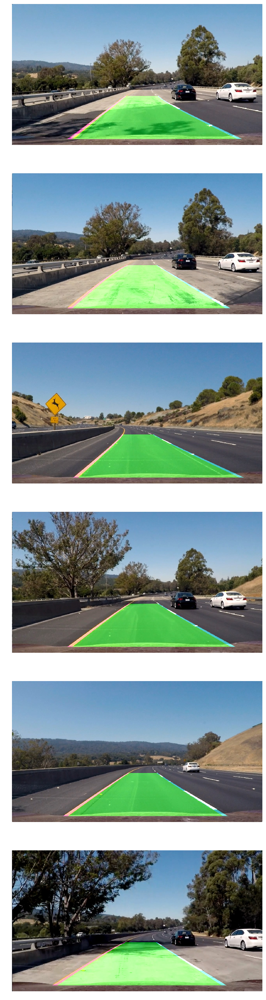

In [35]:
def draw_lane(original_img, binary_img, l_fit, r_fit, Minv):
    new_img = np.copy(original_img)
    if l_fit is None or r_fit is None:
        return original_img
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    h,w = binary_img.shape
    ploty = np.linspace(0, h-1, num=h)# to cover same y-range as image
    left_fitx = l_fit[0]*ploty**2 + l_fit[1]*ploty + l_fit[2]
    right_fitx = r_fit[0]*ploty**2 + r_fit[1]*ploty + r_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (w, h)) 
    # Combine the result with the original image
    result = cv2.addWeighted(new_img, 1, newwarp, 0.5, 0)
    return result

# Set up plot
fig, axs = plt.subplots(len(img_proced),1, figsize=(50, 50))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

for i in range(len(image_orig)):
    img_out1 = draw_lane(image_orig[i], img_proced[i], left_fits[i], right_fits[i], Minvs[i])
    axs[i].imshow(img_out1)
    axs[i].axis('off')

In [36]:
## Draw The Radius of Curvature and Distance

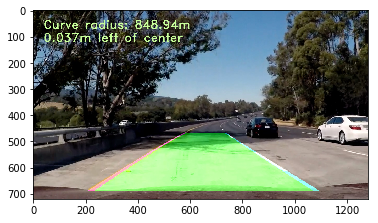

In [37]:
def draw_data(original_img, curv_rad, center_dist):
    new_img = np.copy(original_img)
    h = new_img.shape[0]
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.2f}'.format(curv_rad) + 'm'
    cv2.putText(new_img, text, (40,70), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    direction = ''
    if center_dist > 0:
        direction = 'right'
    elif center_dist < 0:
        direction = 'left'
    abs_center_dist = abs(center_dist)
    text = '{:04.3f}'.format(abs_center_dist) + 'm ' + direction + ' of center'
    cv2.putText(new_img, text, (40,120), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    return new_img

img_out2 = draw_data(img_out1, (rad_l+rad_r)/2, d_center)
plt.imshow(img_out2)

In [38]:
## Apply on Video Frames

[MoviePy] >>>> Building video ./output_videos/project_video_out.mp4
[MoviePy] Writing video ./output_videos/project_video_out.mp4


100%|█████████▉| 1260/1261 [01:54<00:00, 10.96it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./output_videos/project_video_out.mp4 

CPU times: user 3min 56s, sys: 23.8 s, total: 4min 20s
Wall time: 1min 55s


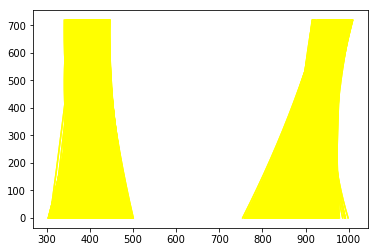

In [39]:
# The video processing loop 
def process_frame(img):
    new_img = np.copy(img)
    img_bin, Minv = pipeline(new_img)
    left_fit, right_fit, out_img = fit_polynomial(img_bin)
    left_lane_inds, right_lane_inds, left_fitx, right_fitx, ploty, result = search_around_poly(img_bin, left_fit, right_fit)
    rad_l, rad_r, d_center = measure_curvature_center_dist(img_bin, left_lane_inds, right_lane_inds, left_fit, right_fit)
    img_out1 = draw_lane(img, img_bin, left_fit, right_fit, Minv)
    img_out2 = draw_data(img_out1, (rad_l+rad_r)/2, d_center)
    return img_out2

video_output1 = './output_videos/project_video_out.mp4'
video_input1 = VideoFileClip('project_video.mp4')#.subclip(22,26)
processed_video = video_input1.fl_image(process_frame)
%time processed_video.write_videofile(video_output1, audio=False)